<a href="https://www.kaggle.com/code/leonanvasconcelos/object-detection-with-pure-computer-vision?scriptVersionId=212920074" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

<h1>Object Detection with Pure Computer Vision</h1>

**Scenario Description: Automated Fruit Detection and Analysis in Agricultural Imaging**
""**Objective:**  
Develop an automated system for detecting, counting, and analyzing round objects (such as fruitgs using advanced image processing and computer vision techniques. This system aims to enhance yield estimation, monitor crop health, and optimize harvesting processes by leveraging high-resolution images captured from various sources like drones or ground-based cameras.

**Computer Vision Methods:**

1. **Image Acquisition:**
   - **Data Collection:** Utilize drones, satellite imagery, or fixed cameras to capture high-resolution images of orchards, plantations, or fruit-bearing areas. Ensure consistent lighting conditions and optimal angles to facilitate accurate detection.
   - **Image Input Options:** Support both direct image file paths (`path_image`) and Base64-encoded image strings (`image64`) to provide flexibility in data sourcing.

2. **Preprocessing:**
   - **Resizing:** Use `resize_image` to standardize image dimensions, ensuring uniformity across different datasets and optimizing processing speed without losing critical details.
   - **Aspect Ratio Adjustment:** Apply `crop_image_to_aspect_ratio` to maintain desired aspect ratios (e.g., 4:3 or 3:4) based on image orientation, enhancing the focus on relevant regions.

3. **Image Enhancement:**
   - **Contrast Enhancement:** Implement `apply_clahe` to improve image contrast adaptively, making fruits more distinguishable from the background.
   - **Color Smoothing:** Utilize `smooth_color` to reduce color noise and enhance the clarity of fruit regions, facilitating better segmentation.

4. **Color Filtering and Mask Generation:**
   - **Color Space Conversion:** Convert images to appropriate color spaces (HSV or LAB) using OpenCV's `cvtColor` for effective color-based segmentation.
   - **Color Range Selection:** Employ `filter_color` to isolate target fruits based on predefined color ranges, generating binary masks that highlight potential fruit regions.
   - **Morphological Operations:** Apply functions like `remove_salt_and_pepper`, `close_mask_circle`, and `expand_mask_circle` to refine masks by eliminating noise, closing gaps, and expanding regions to cover entire fruits.

5. **Foreground and Background Segmentation:**
   - **Foreground Masking:** Combine multiple masks using weighted summation to create a comprehensive foreground mask that accurately represents fruit regions.
   - **Background Masking:** Invert the foreground mask to delineate background areas, enabling separate processing if needed.

6. **Object Detection:**
   - **Circle Detection:** Utilize `detect_circles` with OpenCV's `SimpleBlobDetector` to identify circular shapes corresponding to fruits. Parameters like circularity, convexity, and inertia ratio are fine-tuned to enhance detection accuracy.
   - **Overlap Handling:** Implement `remove_overlapping_circles` to eliminate duplicate detections and ensure each fruit is counted only once.
   - **Visualization:** Use `draw_circles` to annotate detected fruits on the original image, providing visual confirmation and aiding in result verification.

7. **K-Means Clustering (Optional):**
   - **Color Quantization:** Apply `kmeans_recolor` to reduce the color palette of the image, simplifying color variations and potentially improving detection performance in complex backgrounds.
   - **Visualization:** Generate clustered images to analyze color distributions and adjust clustering parameters as needed.

8. **EXIF Metadata Extraction:**
   - **Metadata Retrieval:** Use `extract_metadata_EXIF` to obtain valuable information such as GPS coordinates, capture date, camera model, and manufacturer from image metadata.
   - **Data Integration:** Incorporate EXIF data into the final report for contextual insights, enabling spatial and temporal analysis of fruit distribution and growth patterns.

9. **Post-processing and Reporting:**
   - **Result Compilation:** Aggregate detection results, including the number of fruits detected and accuracy metrics, into a structured JSON format using `format_result`.
   - **Image Saving:** Save annotated images with detection overlays and preprocessed images for record-keeping and further analysis using `save_image`.
   - **Interactive Tuning (Debugging):** Provide functions like `tunning_blur`, `tunning_color`, and `tunning_BlobCircles` with OpenCV trackbars for real-time parameter adjustments, facilitating optimization during development and deployment.

10. **Batch Processing and Automation:**
    - **Batch Mode Support:** Enable processing of multiple images in a directory through the `test_directory` function, automating the detection pipeline and generating summarized accuracy reports.
    - **Error Handling:** Implement robust error handling to manage issues like invalid image paths, decoding errors, and missing EXIF data, ensuring the system's resilience and reliability.

**Benefits:**

- **Efficiency:** Automates the time-consuming process of fruit counting and analysis, allowing farmers and agricultural professionals to focus on decision-making and field operations.
- **Accuracy:** Enhances detection precision through advanced filtering, morphological operations, and customizable parameters, reducing human error and ensuring reliable yield estimates.
- **Scalability:** Capable of handling large datasets from extensive agricultural fields, supporting scalability as operations grow.
- **Cost-Effective:** Reduces the need for manual labor in fruit counting and monitoring, lowering operational costs and increasing overall productivity.

By implementing this comprehensive system, agricultural stakeholders can achieve enhanced monitoring of crop yields, better resource allocation, and informed strategies for crop management, ultimately contributing to increased agricultural efficiency and sustainability.

# 1. Requirements

In [1]:
from PIL import Image as PILImage
import os, random, io, base64, json
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import display


#!jupyter nbextension install --py widgetsnbextension
#!jupyter labextension install @jupyter-widgets/jupyterlab-manager
!jupyter nbextension enable --py widgetsnbextension
!jupyter labextension enable @jupyter-widgets/jupyterlab-manager

import ipywidgets as widgets

Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: OK


## Author functions

All functions used by this notebook are created by Leonan Vasconcelos, 
available on GitHub:

[https://github.com/LeonanUCM/ObjectDetectionPureCV.git](https://github.com/LeonanUCM/ObjectDetectionPureCV.git)

In [2]:
# Import functions created by the author available on GitHub
import os
import cv2

# Clone the repository only if it doesn't exist
if not os.path.exists('./ObjectDetectionPureCV'):
    !git clone https://github.com/LeonanUCM/ObjectDetectionPureCV.git

import sys
sys.path.append('./ObjectDetectionPureCV')

import config_profiles
import utils_cv


Cloning into 'ObjectDetectionPureCV'...
remote: Enumerating objects: 153, done.
remote: Counting objects: 100% (127/127), done.
remote: Compressing objects: 100% (94/94), done.
remote: Total 153 (delta 69), reused 81 (delta 33), pack-reused 26 (from 1)
Receiving objects: 100% (153/153), 123.27 MiB | 31.72 MiB/s, done.
Resolving deltas: 100% (69/69), done.


# 2. Pre processing
## 2.1. Image Loading   - **Data Collection:** Utilize drones, satellite imagery, or fixed cameras to capture high-resolution images of orchards, plantations, or fruit-bearing areas. Ensure consistent lighting conditions and optimal angles to facilitate accurate detection.
   - **Image Input Options:** Support both direct image file paths (`path_image`) and Base64-encoded image strings (`image64`) to provide flexibility in data sourcing..

Image loaded OK.


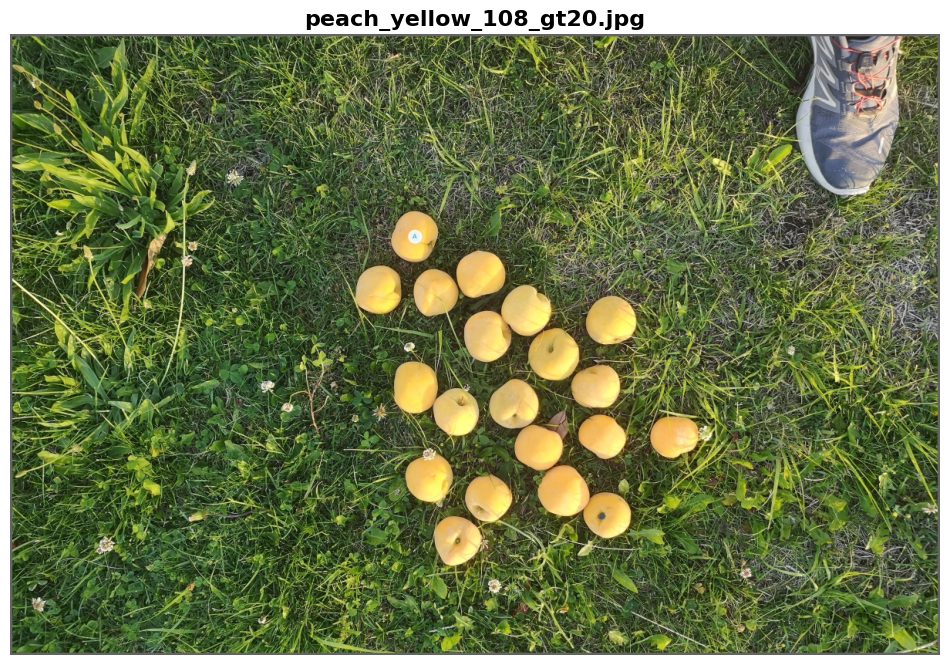

In [3]:
path_image=r"/kaggle/input/fruit-count/test_images/"
file_name='peach_yellow_108_gt20.jpg'
profile='YELLOW_PEACH'

try:
    img_IO = PILImage.open(path_image + file_name)
    img_original = np.array(img_IO)
    print("Image loaded OK.")
except:
    error = '{"error": "Error reading file ' + path_image + '"}'
    print(error)
    raise error

utils_cv.show_mosaic([img_original], window_name=file_name)

## 2.2. EXIF Metadata Extraction
- 
Metadata extraction is a necessary step to gather the information required to prove the authenticity of the photo in a future legal proceeding.
The extracted metadata can also be used to map the locations where the photos were taken, ensuring that a sufficiently representative sample is collected.

In [4]:
result_exif = {}
if utils_cv.extract_metadata_EXIF(img_IO, result_exif):
    print(f"EXIF: coordinates={result_exif.get('coordinates')} \n      date={result_exif.get('capture_date')} \n      model={result_exif.get('mobile_model')}\n      manufacturer={result_exif.get('mobile_manufacturer')}")
img_IO.close()

EXIF: coordinates=(40.485344, -3.653178) 
      date=2024:06:04 20:37:40 
      model=CLT-L29
      manufacturer=HUAWEI


## 2.3. Configuration Loading
   - Loads color profiles and processing configurations based on the specified profile.
   - Ensures that the processing parameters are tailored to the specific color characteristics of the target object object
   - Profiles were generated before, using tunning methods.
   - The idea is to have a light sollution, with no need for large models like CNN, neither trainning with a large dataset...


In [5]:
cfg = config_profiles.load_config(profile)
print(cfg.as_text())



# Profile: YELLOW_PEACH
# Quality:
cfg.quantization_n_colors, cfg.max_resolution, cfg.smooth_colors, cfg.factor_contrast = (3, 1536, 19, 0.98)

# Blur:
cfg.blur_clahe_grid, cfg.blur_clahe_limit, cfg.blur_salt_pepper, cfg.blur_size = (5, 2.5, 5, 5)

# Amplify Saturation:
cfg.color_amplify_hue, cfg.color_amplify_range, cfg.color_amplify_increase = (40, 20, 0.5)

# Foreground selection:
cfg.foreground_list.append([['Foreground Green', -1], [70, 30, 20, 316, 100, 100, 3, 21, 11, 1]])
cfg.foreground_list.append([['Foreground Brown', -1], [0, 3, 8, 32, 39, 85, 1, 21, 11, 1]])
cfg.foreground_list.append([['Foreground Probably', 1], [36, 32, 37, 66, 100, 100, 27, 19, -31, 1]])
cfg.foreground_list.append([['Foreground Certainly', 2], [27, 60, 60, 50, 100, 100, 37, 17, -25, 1]])

# Texture Removal:
cfg.texture_1_kernel_size, cfg.texture_1_threshold_value, cfg.texture_1_noise, cfg.texture_1_expand, cfg.texture_1_it = (29, 5, 1, 3, 1)
cfg.texture_2_kernel_size, cfg.texture_2_threshold_value, cfg

## 2.4. Reduces computational cost

- 
Resizes the image to a maximum resolution to optimize processing speed without compromising essential detail.
>| Original Size | Reduced |
>|---------------|---------|
>| 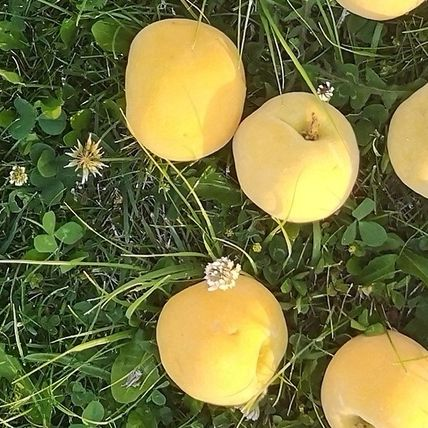 | 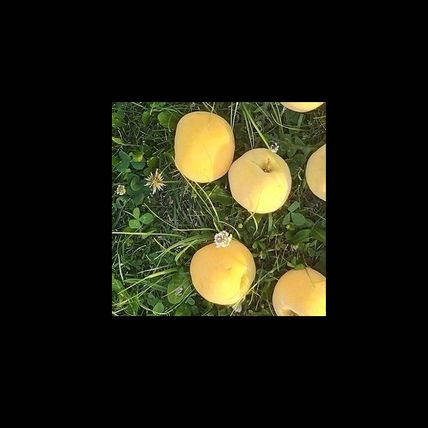 |

- Keeping aspect ratio is important to make sure objects keep its proportion when resized.
CNN models normally requires standard ratio (1:1) and size (640x640), which can be a bit flexible in some cases.
The problem when resizing is that it looses the aspect ratio. So a typical form of a fruit like orange (circle) may become a long ellipse, difficulting the detection.
The advantage of the method proposed on this work is to keep aspect ratio even for very wide cameras like the 9:22 of Samsung Z-flip 
>| Wide (9:22) | Squared (1:1) |
>|-------------|---------------|
>| 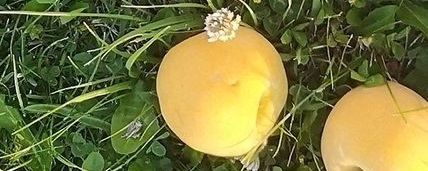 | 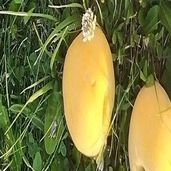 |
1:1).

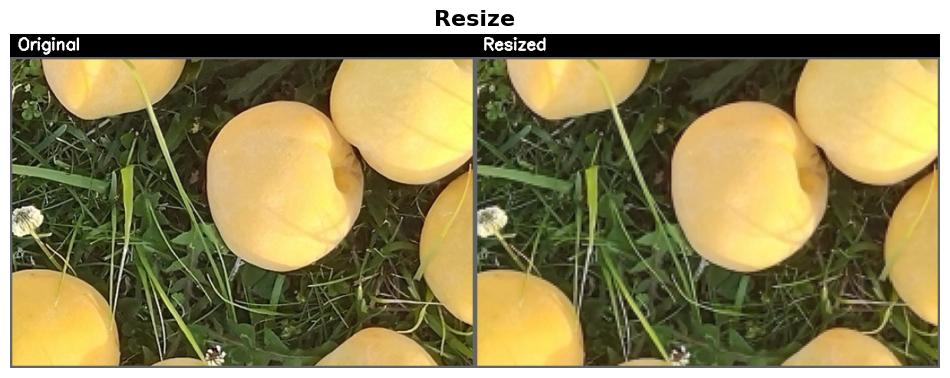

In [6]:
# Resize image to maximum resolution
img_reduced = utils_cv.resize_image(img_original, cfg.max_resolution)
utils_cv.show_mosaic([utils_cv.crop_center(img_original,0.15), utils_cv.crop_center(img_reduced,0.15)], 
                     headers=[f'Original', f'Resized'], window_name='Resize')

In [7]:
# Calculate the size
image_size_details = utils_cv.calculate_image_size(img_original)

# Print the results
print(image_size_details["explanation"])
print(f"Total size of original image: {image_size_details['total_size_mb']} MB")


image_size_details_reduced = utils_cv.calculate_image_size(img_reduced)
print(f"Total size of reduced image: {image_size_details_reduced['total_size_mb']} MB")
reduction = round((1 - image_size_details_reduced['total_size_bytes'] / image_size_details['total_size_bytes'])*100,2)

print(f"Difference: {reduction}% smaller")

The image array has dimensions (2429, 3648, 3).
Each element is of type 'uint8' and takes 1 bytes.
The total number of elements is 26582976, resulting in a total size of 26582976 bytes.
This equals approximately 25.35 MB.
Total size of original image: 25.35 MB
Total size of reduced image: 4.49 MB
Difference: 82.28% smaller


## 2.5. Color Amplification - Enhances the saturation of specific hues to make target objects more distinguishable from the backgroun on images with little saturation<br>
- It may create some defects but will be smoothed later.
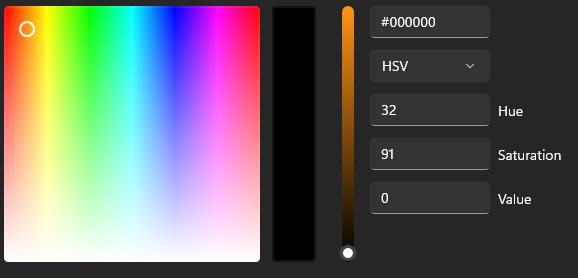

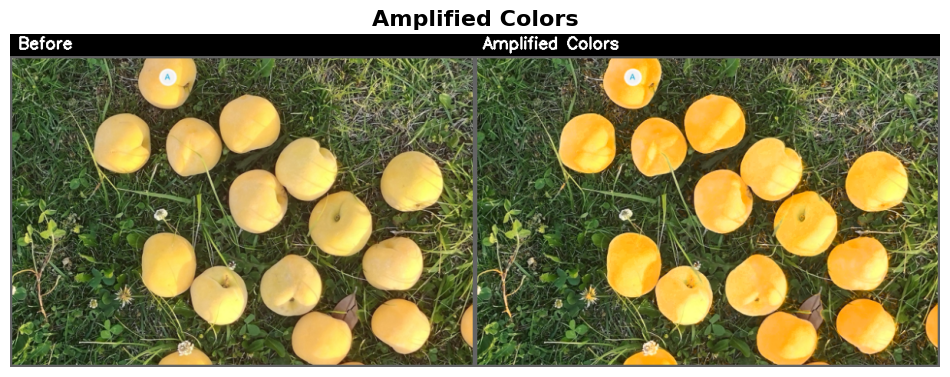

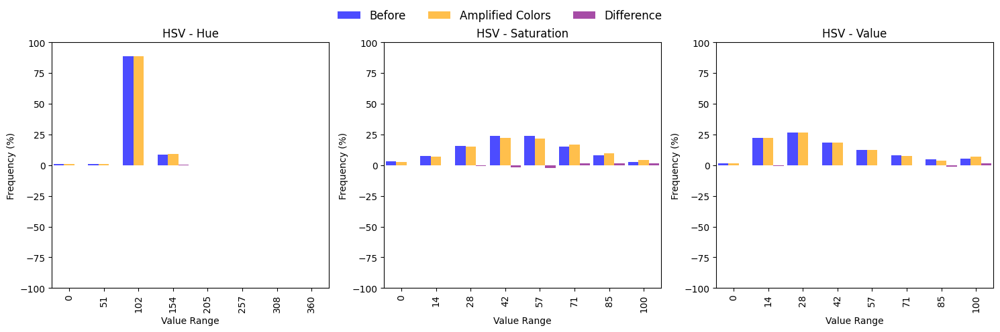

In [8]:
# Amplify saturation around a specific hue to enhance target objects

if cfg.color_amplify_range == 0:
    print('    Skipping Amplify Color')
    img_amplified = img_reduced
else:
    img_amplified = utils_cv.amplify_saturation_near_hue(img_reduced, cfg.color_amplify_hue, cfg.color_amplify_range, cfg.color_amplify_increase)
    
    utils_cv.show_mosaic([utils_cv.crop_center(img_reduced, 0.4), utils_cv.crop_center(img_amplified,0.4)],
                headers=['Before', 'Amplified Colors'],
                window_name=f'Amplified Colors')

    utils_cv.show_histograms(img_reduced, img_amplified, color_spaces=["HSV"], legend="Amplified Colors")


## 2.6. Color Smoothing
   - Applies color smoothing to reduce, including the ones created by last step.

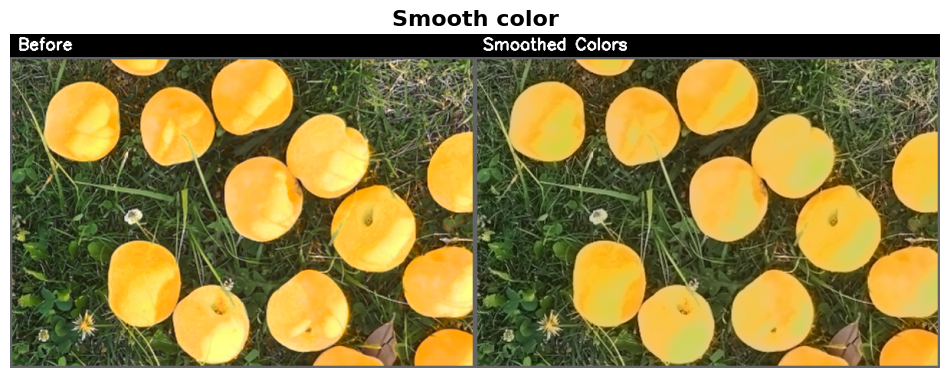

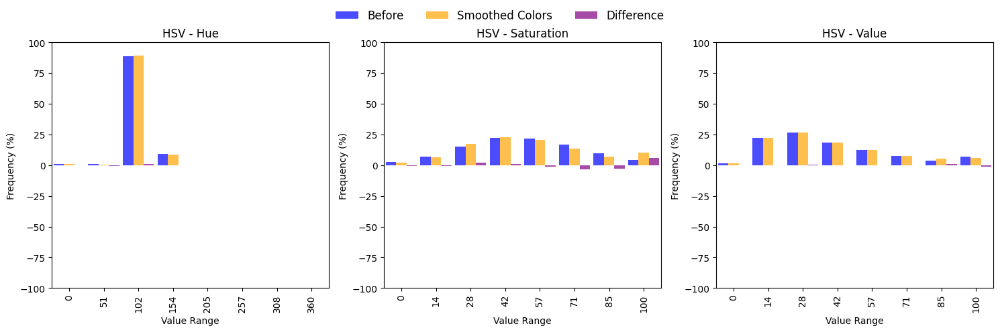

In [9]:
# Apply color smoothing if configured
if cfg.smooth_colors == 0:
    print('    Skipping Smooth Color')
    img_smooth_color = img_amplified
else:
    img_smooth_color = utils_cv.smooth_color(img_amplified, kernel_size=cfg.smooth_colors, min_brightness=20, max_brightness=210)

    utils_cv.show_mosaic([utils_cv.crop_center(img_amplified,0.3), utils_cv.crop_center(img_smooth_color,0.3)], 
                headers=['Before', 'Smoothed Colors'],
                window_name=f'Smooth color')
        

    utils_cv.show_histograms(img_amplified, img_smooth_color, color_spaces=["HSV"], legend="Smoothed Colors")

## 2.7. Removes Texturized Areas- In the objects of our analysis, it can be clearly observed that the fruits studied,<br>
 in this case peaches, have a smooth peel without texture, unlike the background of the image,<br>
 which is the soil, usually sandy, or grass, both of which present a textured surface.
- This operation, even though simplified, removed more than 50% of the image, making the analysis much easier.]

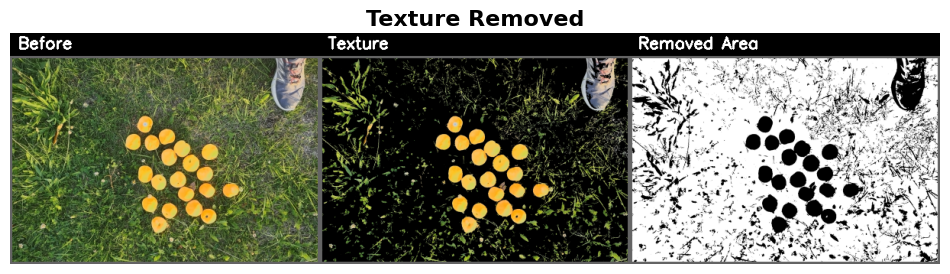

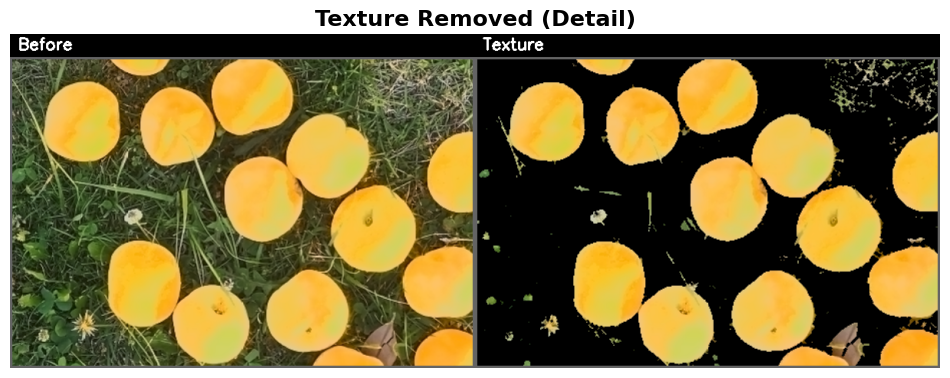

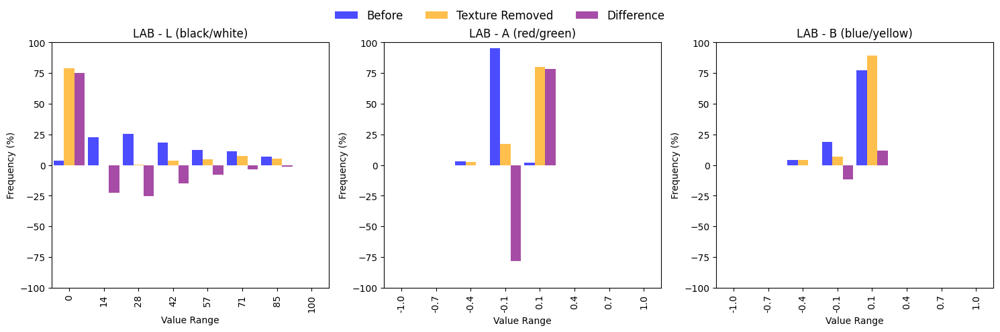

In [10]:
# Remove texture using morphological operations if configured
if cfg.texture_1_kernel_size <= 1:
    print('   Skipping Texture 1')
    img_texture = img_smooth_color
else:
    img_texture, mask = utils_cv.detect_smooth_areas_rgb(img_smooth_color, 
                                kernel_size=cfg.texture_1_kernel_size, 
                                threshold_value=cfg.texture_1_threshold_value, 
                                noise=cfg.texture_1_noise, 
                                expand=cfg.texture_1_expand, 
                                it=cfg.texture_1_it)
    
    utils_cv.show_mosaic([img_smooth_color, img_texture, ~mask],
                headers=['Before', 'Texture', 'Removed Area'],
                window_name=f'Texture Removed')

    utils_cv.show_mosaic([utils_cv.crop_center(img_smooth_color, 0.3), utils_cv.crop_center(img_texture, 0.3)],
                headers=['Before', 'Texture'],
                window_name=f'Texture Removed (Detail)')

    utils_cv.show_histograms(img_smooth_color, img_texture, color_spaces=["LAB"], legend="Texture Removed")


## 2.8. CLAHE   - In this step, we applied Contrast Limited Adaptive Histogram Equalization (CLAHE) to better define the object and undesired noise.
   - Next, we removed the noise from the previous step.
   - Finally, we applied a Gaussian Blur to to further smooth the image.e.

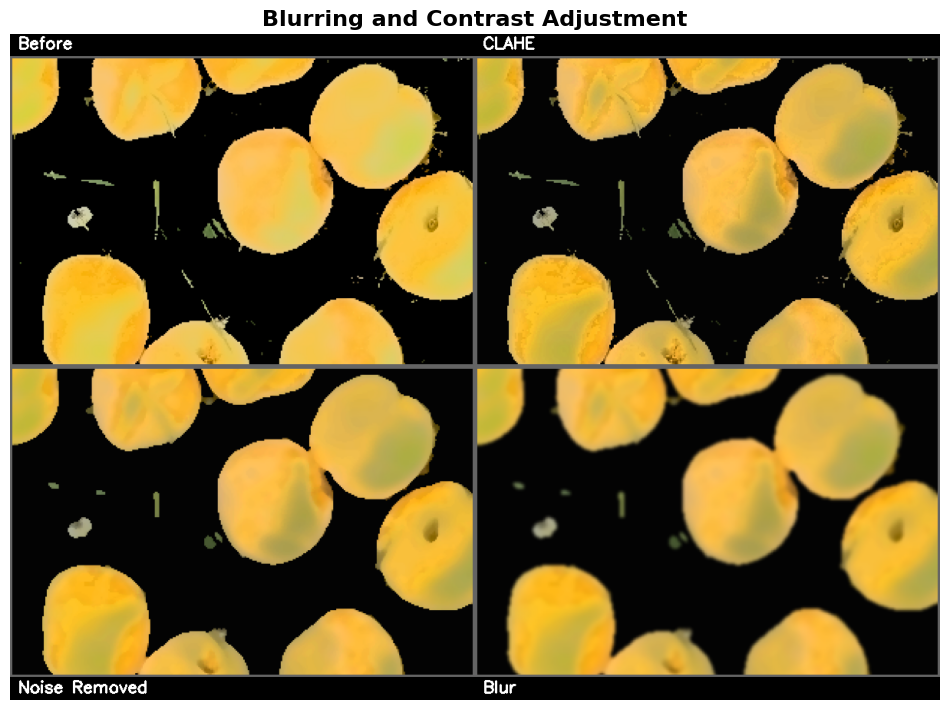

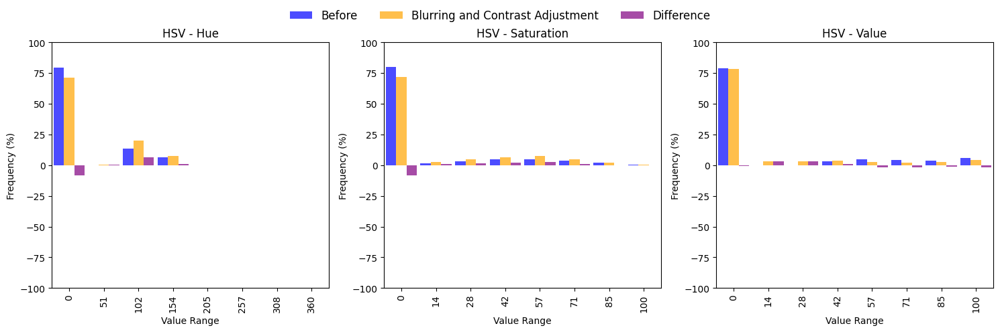

In [11]:
# Apply CLAHE, remove noise, and apply Gaussian blur
_, img_clahe, _ = utils_cv.apply_clahe(img_texture, 
                            tileGridSize=(cfg.blur_clahe_grid, cfg.blur_clahe_grid), 
                            clipLimit=cfg.blur_clahe_limit)
img_noise = utils_cv.remove_salt_and_pepper(img_clahe, kernel_size=cfg.blur_salt_pepper)
img_clahe_blur = utils_cv.blur_image(img_noise, kernel_size=cfg.blur_size)


utils_cv.show_mosaic([utils_cv.crop_center(img_texture,0.2), utils_cv.crop_center(img_clahe,0.2), utils_cv.crop_center(img_noise,0.2), utils_cv.crop_center(img_clahe_blur,0.2)],
            mosaic_dims=(2,2),
            headers=['Before', 'CLAHE'],
            footers=['Noise Removed', 'Blur'],
            window_name=f'Blurring and Contrast Adjustment')

utils_cv.show_histograms(img_texture, img_clahe_blur, color_spaces=["HSV"], legend="Blurring and Contrast Adjustment")

## 2.9. Foreground Selection
   - Combines multiple color filters to create a comprehensive mask highlighting the foreground objects.
   - Differentiates between certain and probable object regions for more accurate detection.

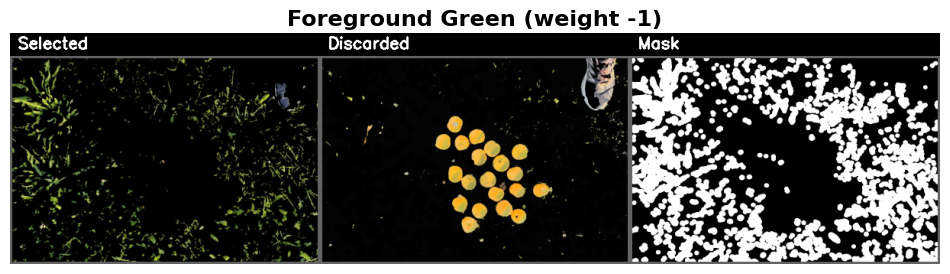

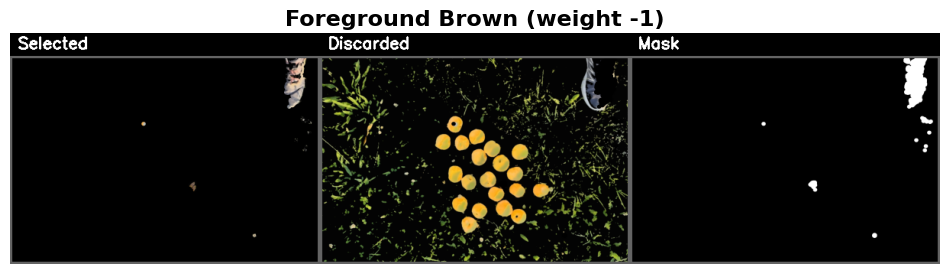

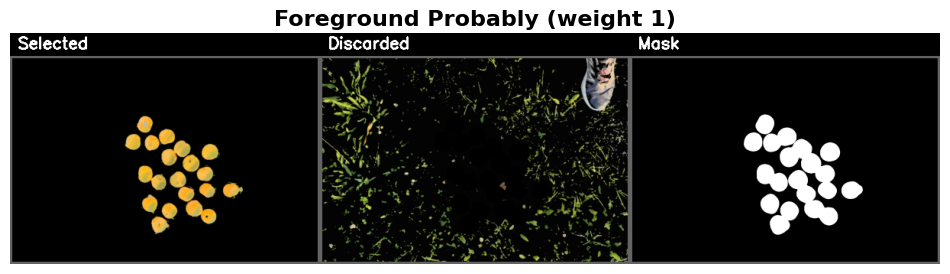

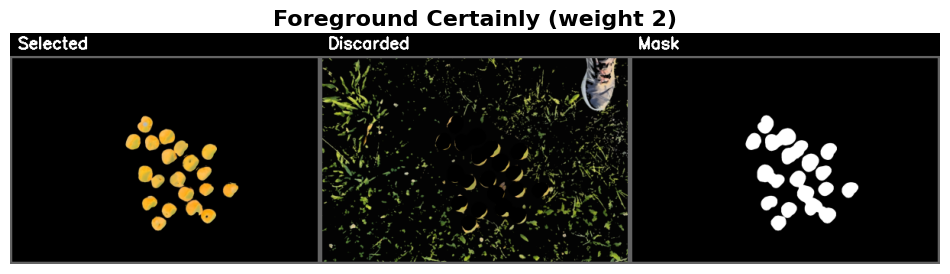

In [12]:
img_before = img_clahe_blur.copy()
img_tmp = img_before.copy()
mask_tmp = np.zeros(img_tmp.shape[:2], dtype=np.int8)


# Iterate through the list of foreground colors to create masks
for i in range(len(cfg.foreground_list)):
    cfg.foreground_name = cfg.foreground_list[i][0][0]
    cfg.foreground_weight = cfg.foreground_list[i][0][1]
    color_space = 'LAB' if 'LAB' in cfg.foreground_name else 'HSV'

    if cfg.foreground_weight != 0:
        selected_area, discarded_area, mask_selected = utils_cv.filter_color(img_tmp, 
                                                        color_ini=cfg.foreground_list[i][1][0:3], 
                                                        color_end=cfg.foreground_list[i][1][3:6],  
                                                        noise=cfg.foreground_list[i][1][6],
                                                        expand=cfg.foreground_list[i][1][7],
                                                        close=cfg.foreground_list[i][1][8],
                                                        iterations=cfg.foreground_list[i][1][9],
                                                        color_space=color_space)

        utils_cv.show_mosaic([selected_area, discarded_area, mask_selected], 
                    headers=['Selected', 'Discarded', 'Mask'],
                    window_name=f'{cfg.foreground_name} (weight {cfg.foreground_weight})')
        
        # Accumulate mask weights based on configuration
        mask_tmp += np.where(mask_selected > 0, cfg.foreground_weight, 0)

        del selected_area, discarded_area, mask_selected
    print('')

# Create a binary foreground mask
mask_foreground = np.where(mask_tmp >= 1, 255, 0).astype('uint8')
if '' in cfg.profile:
    mask_foreground = utils_cv.expand_mask_circle(mask_foreground, kernel_size=7, iterations=1)

# Apply the foreground mask to the smoothed color image
img_foreground = cv2.bitwise_and(img_smooth_color, img_smooth_color, mask=mask_foreground)
img_background = cv2.bitwise_and(img_smooth_color, img_smooth_color, mask=~mask_foreground)

As brighter the mask is, more probably it is an object:


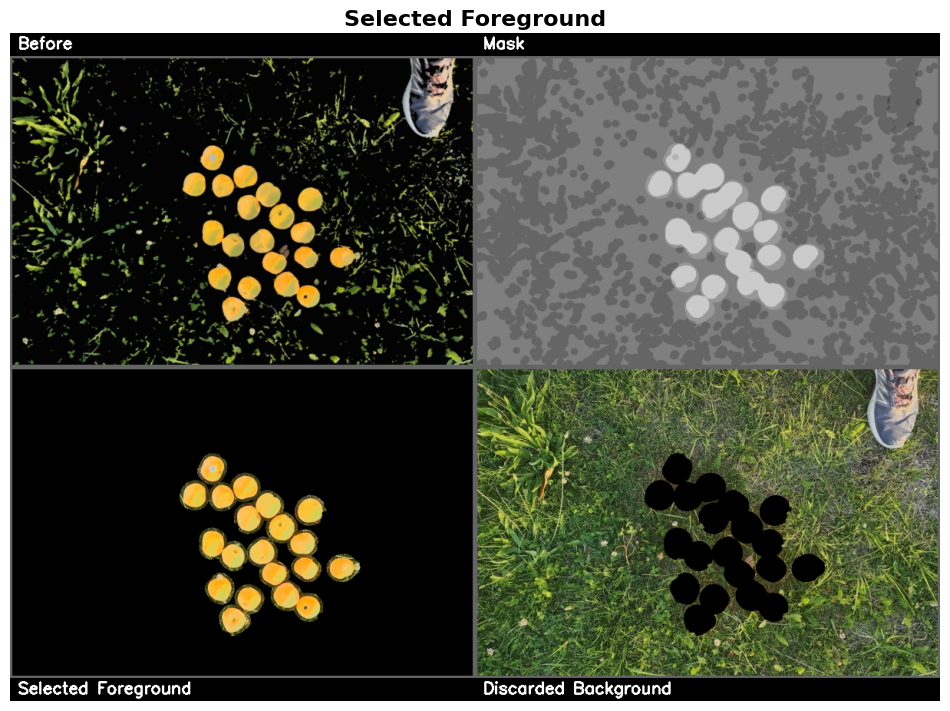

In [13]:
print("As brighter the mask is, more probably it is an object:")
mask_normal = utils_cv.normalize_mask_to_uin8(mask_tmp)

utils_cv.show_mosaic([img_before, mask_normal, img_foreground, img_background],
                     mosaic_dims=(2,2),
                     headers=['Before', 'Mask'],
                     footers=['Selected Foreground', 'Discarded Background'],
                     window_name=f'Selected Foreground')

## 2.10. Quantization
        - Applies K-Means clustering to reduce the color palette, simplifying color variations and potentially improving detection accuracy.

Applying KMeans
Coloring Viridis
Recoloring based on original
KMeans finished


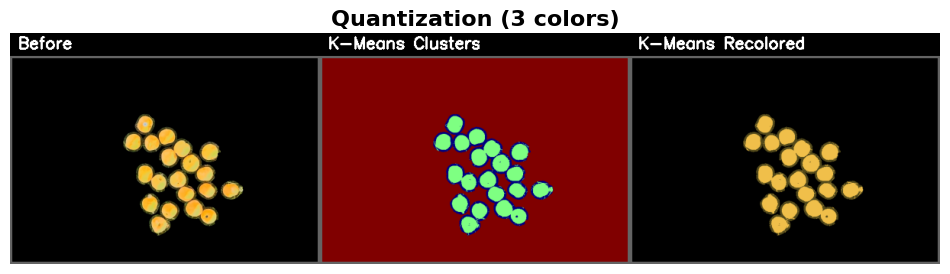

In [14]:
# Apply K-Means color quantization if configured
if cfg.quantization_n_colors == 0:
    debug_print('    Skipping Quantization')
    img_quantization = img_foreground
else:
    # Perform color quantization
    img_preprocessed, clustered_rgb, clustered_labels = utils_cv.kmeans_recolor(img_foreground, n_clusters=cfg.quantization_n_colors)

    utils_cv.show_mosaic([img_foreground, clustered_rgb, img_preprocessed], 
                headers=['Before', 'K-Means Clusters', 'K-Means Recolored'], 
                window_name=f'Quantization ({cfg.quantization_n_colors} colors)')
            

## 2.11. Refinement
        - Refines object outline.

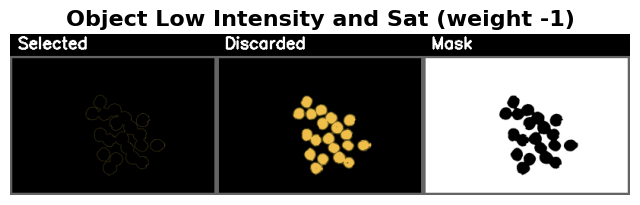

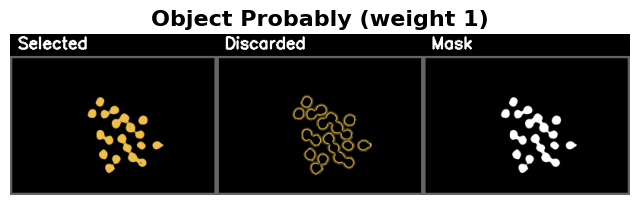

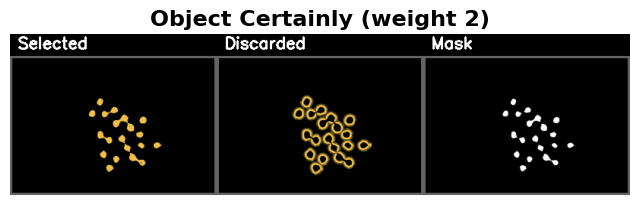

In [15]:
img_before = img_preprocessed
img_tmp = img_before
mask_tmp = np.zeros(img_tmp.shape[:2], dtype=np.int8)
mask_certainly_object = np.zeros(img_tmp.shape[:2], dtype=np.uint8)

# Iterate through the list of target colors to create masks for object detection
for i in range(len(cfg.color_list)):
    cfg.color_name = cfg.color_list[i][0][0]
    cfg.color_weight = cfg.color_list[i][0][1]

    if cfg.color_weight != 0:
        selected_area, discarded_area, mask_selected = utils_cv.filter_color(img_tmp, 
                                                        color_ini=cfg.color_list[i][1][0:3], 
                                                        color_end=cfg.color_list[i][1][3:6],  
                                                        noise=cfg.color_list[i][1][6],
                                                        expand=cfg.color_list[i][1][7],
                                                        close=cfg.color_list[i][1][8],
                                                        iterations=cfg.color_list[i][1][9])
        
        # Save a mask for areas that are certain to be objects (e.g., fruits)
        if cfg.color_weight >= 2:
            mask_rounded = cv2.bitwise_or(mask_certainly_object, mask_selected)
            if cfg.smooth_mask_certain >= 3:
                kernel_size = cfg.smooth_mask_certain
                mask_rounded = utils_cv.erode_mask_circle(mask_rounded, kernel_size=kernel_size, iterations=1)
                mask_rounded = utils_cv.expand_mask_circle(mask_rounded, kernel_size=kernel_size, iterations=1)
                mask_rounded = utils_cv.erode_mask_circle(mask_rounded, kernel_size=utils_cv.make_odd(kernel_size/2), iterations=2)
                mask_rounded = utils_cv.expand_mask_circle(mask_rounded, kernel_size=utils_cv.make_odd(kernel_size/2), iterations=1)
            mask_certainly_object = mask_rounded.astype('uint8')
            mask_selected = mask_certainly_object

        utils_cv.show_mosaic([selected_area, discarded_area, mask_selected], 
                    headers=['Selected', 'Discarded', 'Mask'],
                    window_name=f'{cfg.color_name} (weight {cfg.color_weight})',
                    max_resolution=800)
        
        # Accumulate mask weights based on configuration
        mask_tmp += np.where(mask_selected > 0, cfg.color_weight, 0)

        del selected_area, discarded_area, mask_selected

As brighter the mask is, more probably it is an object:


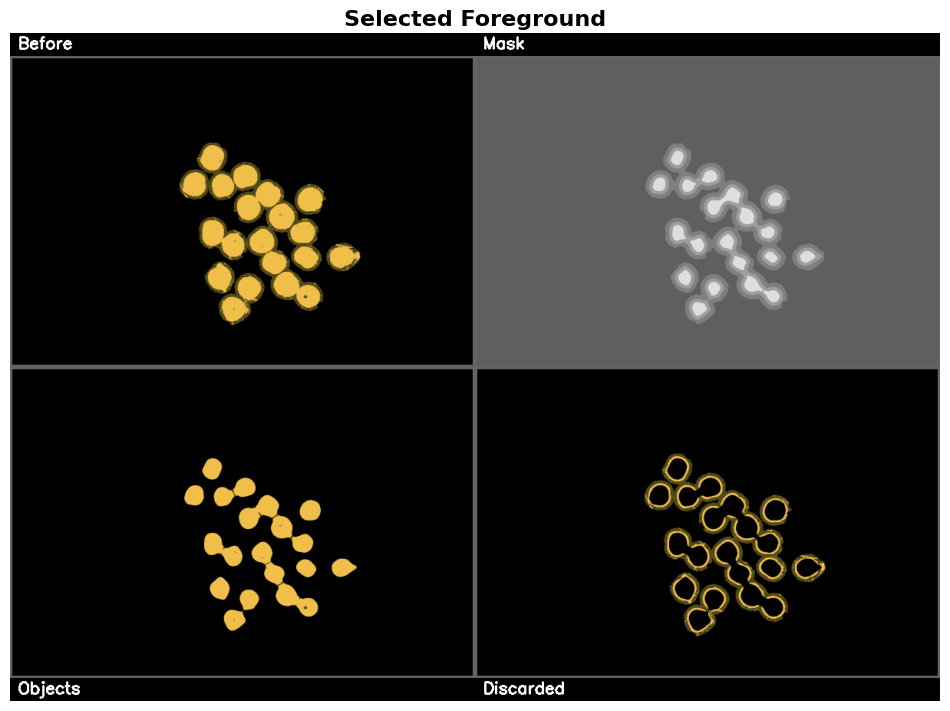

In [16]:
# Create a binary mask for objects
mask_objects = np.where(mask_tmp >= 1, 255, 0).astype('uint8')
img_objects = cv2.bitwise_and(img_before, img_before, mask=mask_objects)
img_discarded = cv2.bitwise_and(img_before, img_before, mask=~mask_objects)
img_preprocessed = img_objects

print("As brighter the mask is, more probably it is an object:")
mask_normal = utils_cv.normalize_mask_to_uin8(mask_tmp)

utils_cv.show_mosaic([img_before, mask_normal, img_objects, img_discarded],
                     mosaic_dims=(2,2),
                     headers=['Before', 'Mask'],
                     footers=['Objects', 'Discarded'],
                     window_name=f'Selected Foreground')

## Result of Preprocessing

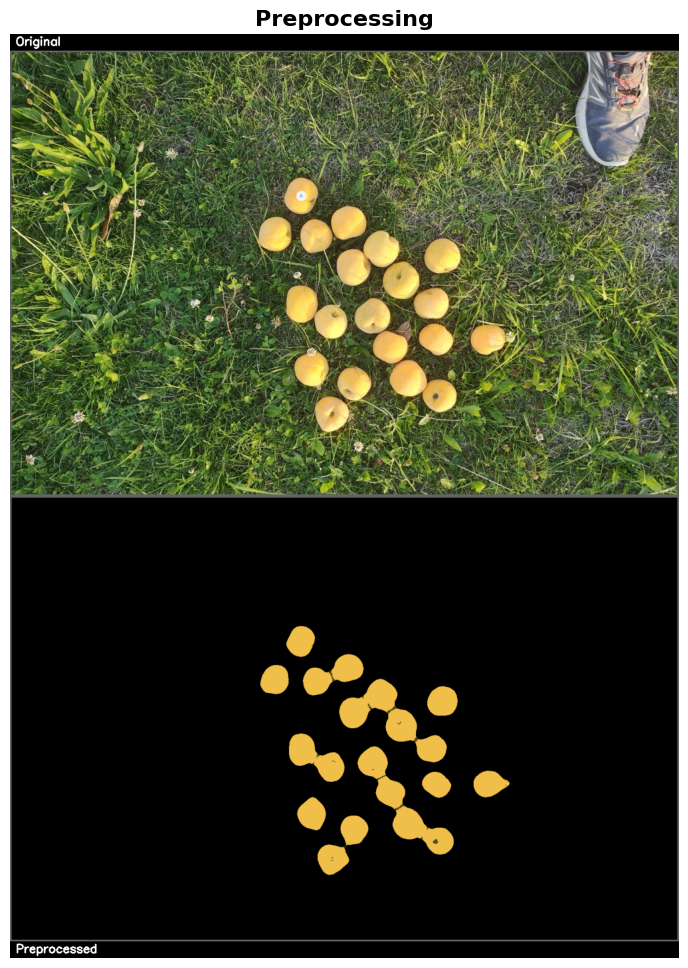

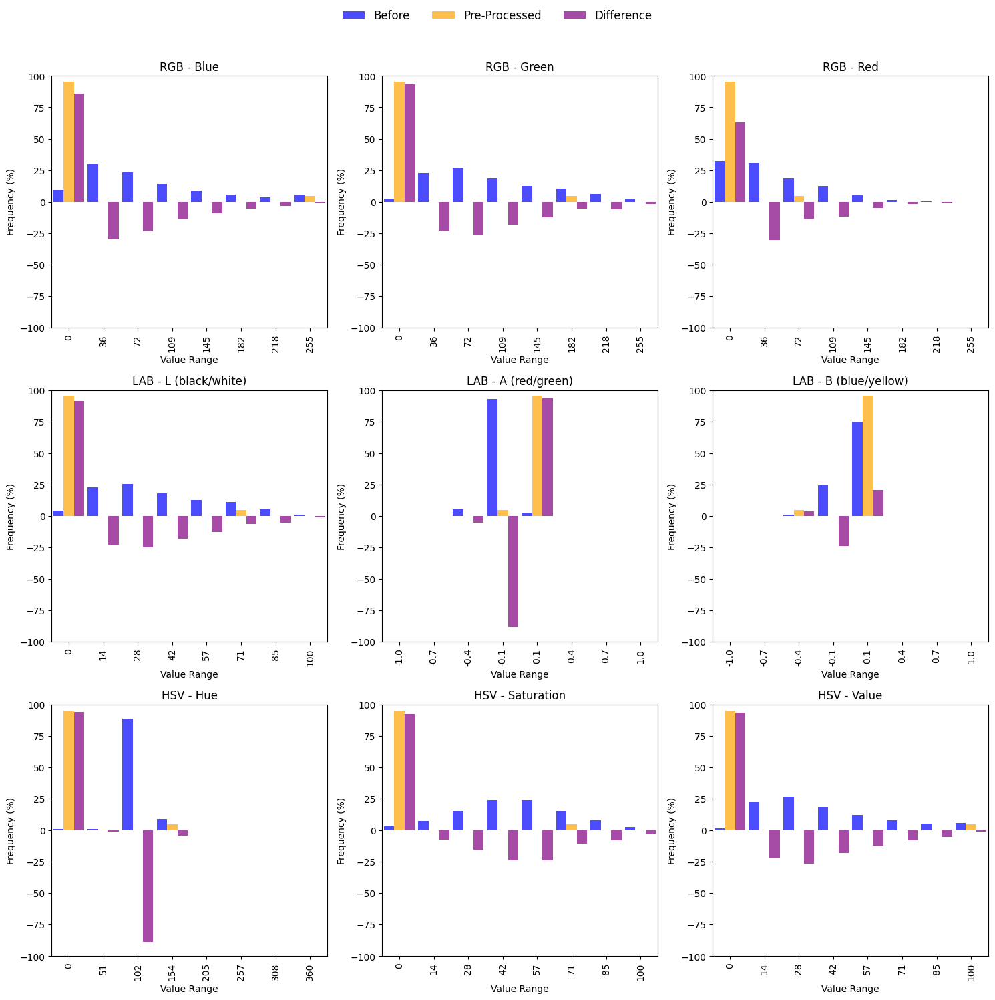

In [17]:
utils_cv.show_mosaic([img_reduced, img_preprocessed], 
            mosaic_dims=(2,1),
            headers=['Original'], 
            footers=['Preprocessed'], 
            window_name='Preprocessing')

utils_cv.show_histograms(img_reduced, img_preprocessed, legend="Pre-Processed")

# 3. Mask preparation
- Creates a new image, based on input, in order to ease object detection based on circles.

## 3.1. Fill holes
- Rounded objects with holes need to be filled to allow future detection of circles.
- Note last fruit on bottom rigth.

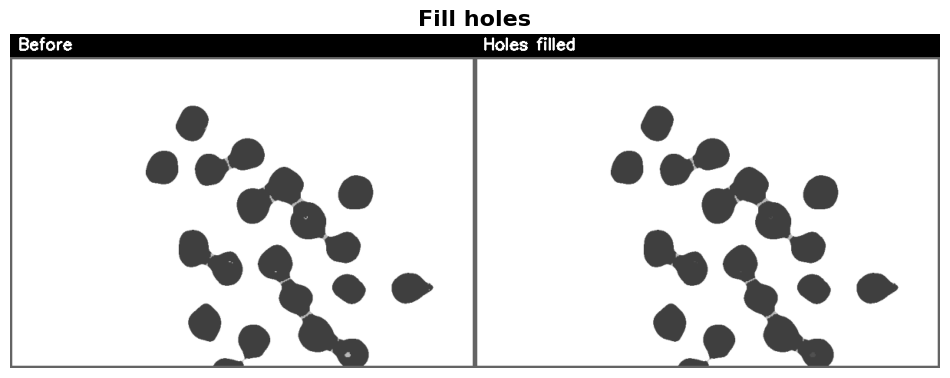

In [18]:
if cfg.fill_holes == 0:
    debug_print('Skipping Fill holes')
    img_filled = cv2.cvtColor(255-img_objects, cv2.COLOR_RGB2GRAY).copy()
else:    
    img_tmp = cv2.cvtColor(255-img_objects, cv2.COLOR_RGB2GRAY).copy()
    img_before = img_tmp.copy()
    img_filled = utils_cv.fill_holes_with_gray(img_tmp, cfg.fill_holes);
    
    utils_cv.show_mosaic([utils_cv.crop_center(img_before,0.6), utils_cv.crop_center(img_filled,0.6)], 
                window_name='Fill holes', 
                headers=['Before', 'Holes filled'])

## 3.2. Improve mask
- Creates a non-binary mask to try to distinguish two very close objects.
- Also helps to remove small imperfections. 

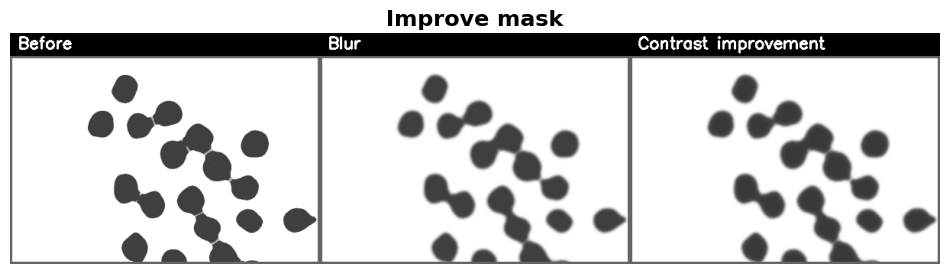

In [19]:
img_tmp = img_filled.copy()

# Convert mask to grayscale and invert
img_before = img_tmp

# Apply noise removal and blurring to the mask
img_tmp = utils_cv.remove_salt_and_pepper(img_tmp, kernel_size=9)
img_tmp = utils_cv.blur_image(img_tmp, kernel_size=19)
img_gray_blur = img_tmp.copy()

# Enhance visibility of certain objects, making it darker
if cfg.factor_contrast != 1:
    img_tmp = np.where(mask_certainly_object > 0, img_tmp**cfg.factor_contrast, img_tmp).astype('uint8')

img_objects_improved = img_tmp.copy()

utils_cv.show_mosaic([utils_cv.crop_center(img_before,0.5), utils_cv.crop_center(img_gray_blur,0.5), utils_cv.crop_center(img_objects_improved,0.5)], 
            window_name='Improve mask', 
            headers=['Before', 'Blur', 'Contrast improvement'])

# Detect Objects

    Turn 0: 11 circles detected.
    Turn 1: 14 circles detected.
    Turn 2: 3 circles detected.
    Turn 3: 5 circles detected.
    Turn 4: 6 circles detected.
   Last attempt to detect circles.
    Turn 5: 1 circles detected.
    40 circles detected before remove overlap.
    20 circles detected after remove overlap.


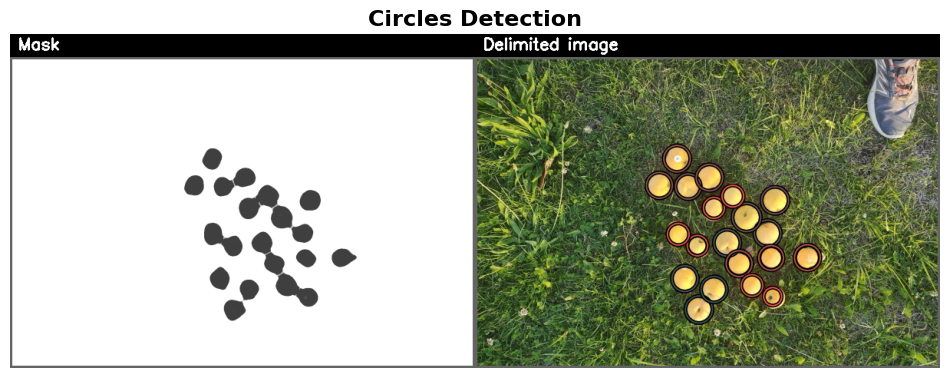

In [20]:
# Detect circles representing objects
circles, img_delimited, mask_circles = \
    utils_cv.detect_circles(img_filled, img_original=img_reduced,
                    minCircularity=cfg.circle_minCircularity, 
                    minConvexity=cfg.circle_minConvexity, 
                    minInertiaRatio=cfg.circle_minInertiaRatio, 
                    minArea=cfg.circle_minArea, 
                    maxArea=cfg.circle_maxArea,
                    min_radius=cfg.min_radius_circle,
                    tolerance_overlap=cfg.tolerance_overlap)

num_circles = len(circles)

utils_cv.show_mosaic([img_filled, img_delimited], 
            window_name='Circles Detection', 
            headers=['Mask', 'Delimited image'])

# Final Result

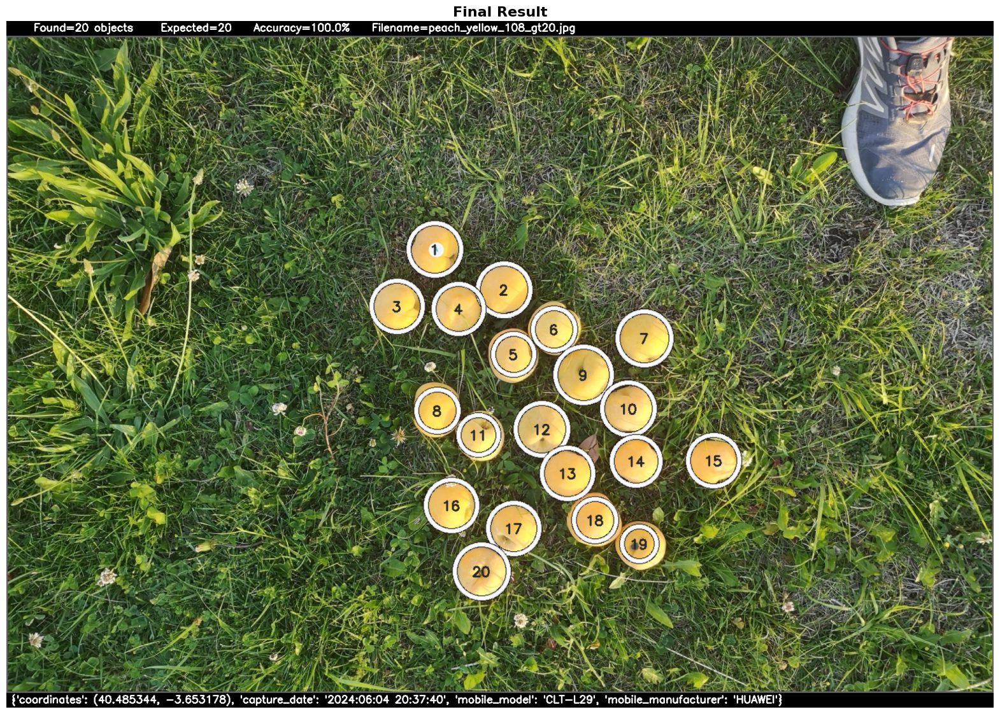

In [21]:
# Draw detected circles on the original smoothed color image
img_final = utils_cv.draw_circles(img_reduced, circles, show_label=True, solid=False)

# Calculate accuracy if ground truth is available
num_found_objects = num_circles

try:
    # Extract expected number of objects from filename
    num_expected_objects = int(file_name[file_name.find("_gt") + 3:file_name.rfind(".")])
    accuracy = 100 * num_found_objects / num_expected_objects
    filename_result = f"{file_name}_result_pd=[{num_found_objects}]acc=[{accuracy:.1f}pct].jpg"
    header_image = f"    Found={num_found_objects} objects     Expected={num_expected_objects}    Accuracy={accuracy:.1f}%"
except:
    num_expected_objects = -1
    accuracy = -1
    filename_result = f"{file_name}_result.jpg"
    header_image = f"    Found={num_found_objects} objects"

header_image += f"    Filename={file_name}" if file_name != '' else ''
footer_image = f"{result_exif}"

utils_cv.show_mosaic([img_final], 
            headers=[header_image],
            footers=[footer_image],
            window_name='Final Result',
            max_resolution=2000)

# Batch test:

      

In [22]:
result_images = utils_cv.test_directory(r"/kaggle/input/fruit-count/test_images", cfg)

Directory: /kaggle/input/fruit-count/test_images


  0%|          | 0/10 [00:00<?, ?it/s]

File: peach_yellow_102_gt20.jpg
Applying KMeans
Coloring Viridis
Recoloring based on original
KMeans finished
    Turn 0: 14 circles detected.
    Turn 1: 18 circles detected.
    Turn 2: 5 circles detected.
    Turn 3: 1 circles detected.
    Turn 4: 0 circles detected.
   Last attempt to detect circles.
    Turn 5: 0 circles detected.


 10%|█         | 1/10 [00:02<00:18,  2.03s/it]

    38 circles detected before remove overlap.
    19 circles detected after remove overlap.
    Saved: /kaggle/working/peach_yellow_102_gt20.jpg
File: peach_yellow_106_gt20.jpg
Applying KMeans
Coloring Viridis
Recoloring based on original
KMeans finished
    Turn 0: 14 circles detected.
    Turn 1: 16 circles detected.
    Turn 2: 4 circles detected.
    Turn 3: 4 circles detected.
    Turn 4: 2 circles detected.
   Last attempt to detect circles.
    Turn 5: 0 circles detected.


 20%|██        | 2/10 [00:03<00:15,  1.98s/it]

    40 circles detected before remove overlap.
    20 circles detected after remove overlap.
    Saved: /kaggle/working/peach_yellow_106_gt20.jpg
File: peach_yellow_108_gt20.jpg
Applying KMeans
Coloring Viridis
Recoloring based on original
KMeans finished
    Turn 0: 11 circles detected.
    Turn 1: 14 circles detected.
    Turn 2: 3 circles detected.
    Turn 3: 4 circles detected.
    Turn 4: 6 circles detected.
   Last attempt to detect circles.
    Turn 5: 2 circles detected.


 30%|███       | 3/10 [00:05<00:13,  1.90s/it]

    40 circles detected before remove overlap.
    20 circles detected after remove overlap.
    Saved: /kaggle/working/peach_yellow_108_gt20.jpg
File: peach_yellow_109_gt20.jpg
Applying KMeans
Coloring Viridis
Recoloring based on original
KMeans finished
    Turn 0: 9 circles detected.
    Turn 1: 11 circles detected.
    Turn 2: 5 circles detected.
    Turn 3: 4 circles detected.
    Turn 4: 5 circles detected.
   Last attempt to detect circles.
    Turn 5: 4 circles detected.


 40%|████      | 4/10 [00:07<00:11,  1.92s/it]

    38 circles detected before remove overlap.
    19 circles detected after remove overlap.
    Saved: /kaggle/working/peach_yellow_109_gt20.jpg
File: peach_yellow_100_gt20.jpg
Applying KMeans
Coloring Viridis
Recoloring based on original
KMeans finished
    Turn 0: 1 circles detected.
    Turn 1: 10 circles detected.
    Turn 2: 11 circles detected.
    Turn 3: 8 circles detected.
    Turn 4: 8 circles detected.


 50%|█████     | 5/10 [00:09<00:09,  1.92s/it]

   Last attempt to detect circles.
    Turn 5: 2 circles detected.
    40 circles detected before remove overlap.
    20 circles detected after remove overlap.
    Saved: /kaggle/working/peach_yellow_100_gt20.jpg
File: peach_yellow_105_gt20.jpg
Applying KMeans
Coloring Viridis
Recoloring based on original
KMeans finished
    Turn 0: 11 circles detected.
    Turn 1: 17 circles detected.
    Turn 2: 8 circles detected.
    Turn 3: 2 circles detected.
    Turn 4: 1 circles detected.
   Last attempt to detect circles.


 60%|██████    | 6/10 [00:11<00:07,  1.98s/it]

    Turn 5: 0 circles detected.
    39 circles detected before remove overlap.
    20 circles detected after remove overlap.
    Saved: /kaggle/working/peach_yellow_105_gt20.jpg
File: peach_yellow_101_gt20.jpg
Applying KMeans
Coloring Viridis
Recoloring based on original
KMeans finished
    Turn 0: 8 circles detected.
    Turn 1: 19 circles detected.
    Turn 2: 12 circles detected.
    Turn 3: 1 circles detected.
    Turn 4: 0 circles detected.
   Last attempt to detect circles.


 70%|███████   | 7/10 [00:13<00:05,  1.98s/it]

    Turn 5: 0 circles detected.
    40 circles detected before remove overlap.
    20 circles detected after remove overlap.
    Saved: /kaggle/working/peach_yellow_101_gt20.jpg
File: peach_yellow_107_gt20.jpg
Applying KMeans
Coloring Viridis
Recoloring based on original
KMeans finished
    Turn 0: 9 circles detected.
    Turn 1: 14 circles detected.
    Turn 2: 5 circles detected.
    Turn 3: 6 circles detected.
    Turn 4: 6 circles detected.
   Last attempt to detect circles.
    Turn 5: 0 circles detected.


 80%|████████  | 8/10 [00:15<00:03,  1.96s/it]

    40 circles detected before remove overlap.
    20 circles detected after remove overlap.
    Saved: /kaggle/working/peach_yellow_107_gt20.jpg
File: peach_yellow_103_gt20.jpg
Applying KMeans
Coloring Viridis
Recoloring based on original
KMeans finished
    Turn 0: 12 circles detected.
    Turn 1: 18 circles detected.
    Turn 2: 7 circles detected.
    Turn 3: 2 circles detected.
    Turn 4: 1 circles detected.
   Last attempt to detect circles.
    Turn 5: 0 circles detected.


 90%|█████████ | 9/10 [00:17<00:01,  1.94s/it]

    40 circles detected before remove overlap.
    20 circles detected after remove overlap.
    Saved: /kaggle/working/peach_yellow_103_gt20.jpg
File: peach_yellow_104_gt20.jpg
Applying KMeans
Coloring Viridis
Recoloring based on original
KMeans finished
    Turn 0: 12 circles detected.
    Turn 1: 18 circles detected.
    Turn 2: 6 circles detected.
    Turn 3: 1 circles detected.
    Turn 4: 0 circles detected.
   Last attempt to detect circles.
    Turn 5: 0 circles detected.


100%|██████████| 10/10 [00:19<00:00,  1.94s/it]

    37 circles detected before remove overlap.
    19 circles detected after remove overlap.
    Saved: /kaggle/working/peach_yellow_104_gt20.jpg


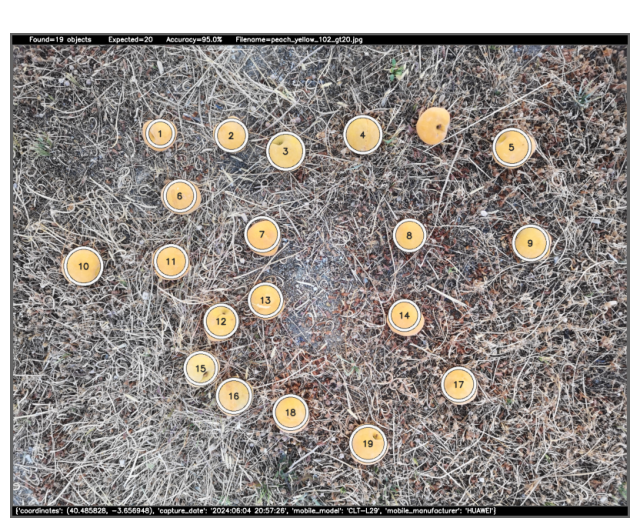

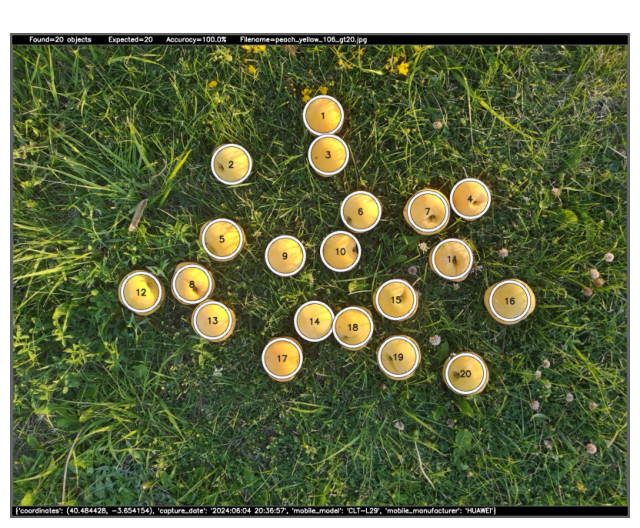

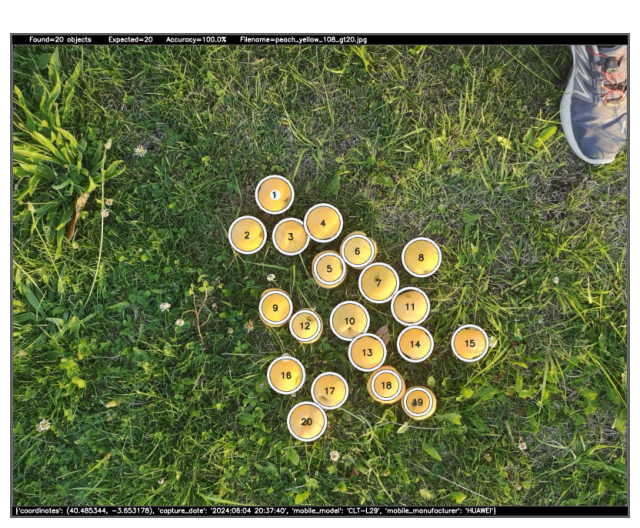

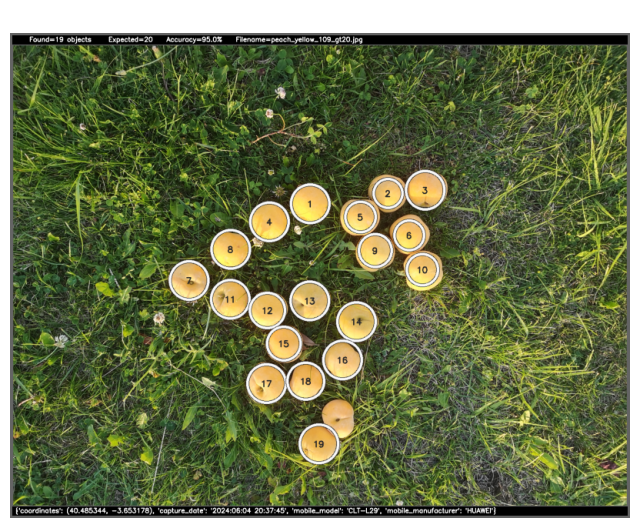

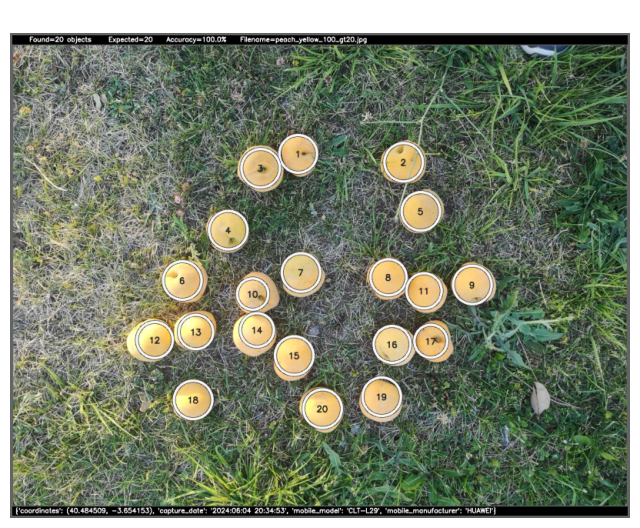

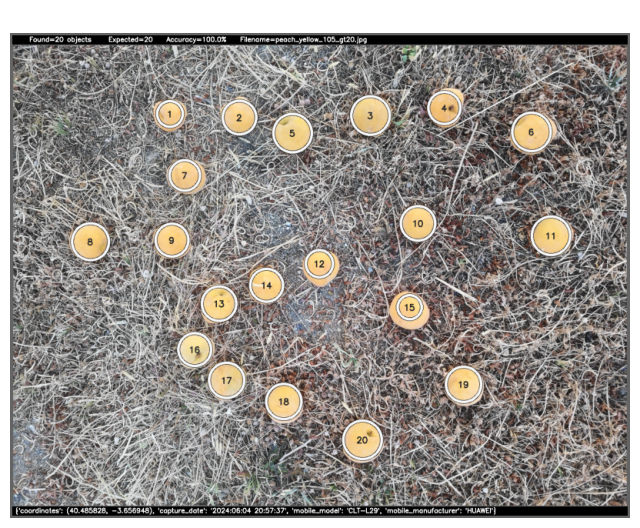

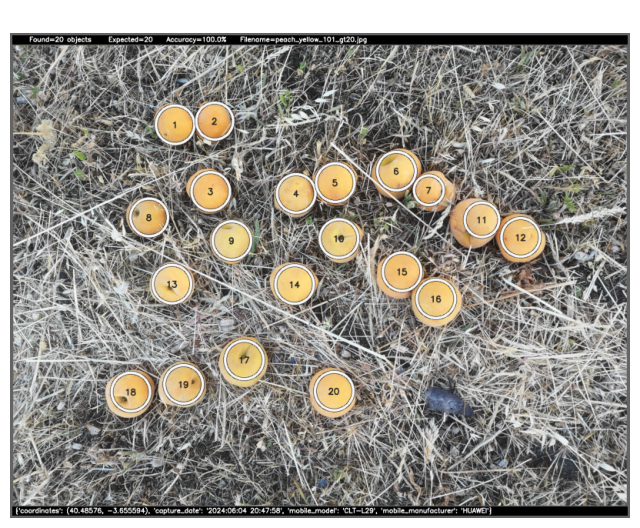

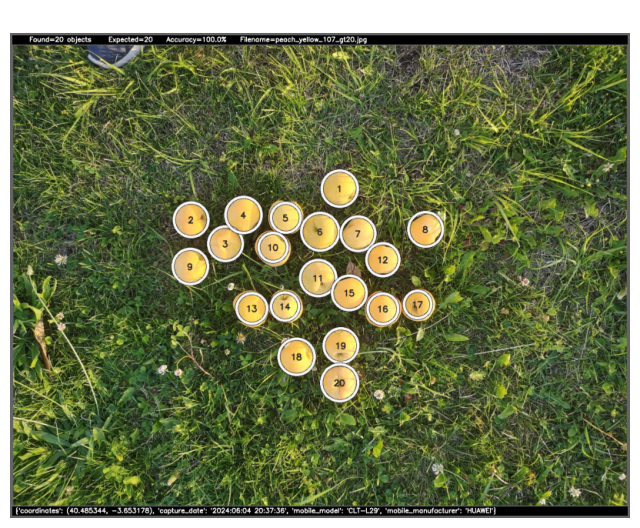

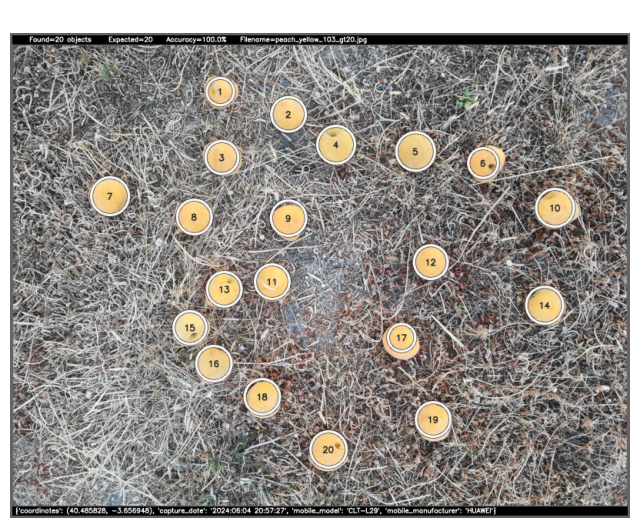

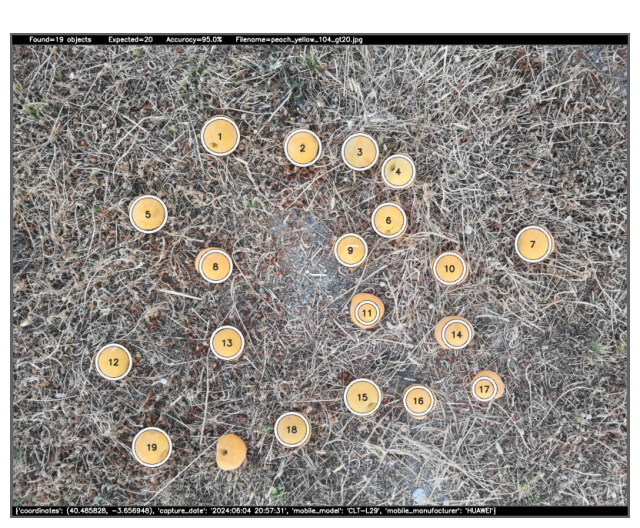

In [23]:
for result in result_images:
    utils_cv.show_mosaic([result], window_name = ' ', max_resolution=800)